# Лабораторная работа №1

Волков М. А.

Группа: М8О-407Б-19

## Обработка данных

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

Датасет [Water quality](https://www.kaggle.com/datasets/mssmartypants/water-quality)

In [3]:
data = pd.read_csv('classification.csv')

In [4]:
data.head(10)

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1
5,0.94,14.47,0.03,2.88,0.003,0.80,0.43,1.38,0.11,0.67,...,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02,1
6,2.36,5.6,0.01,1.35,0.004,1.28,0.62,1.88,0.33,0.13,...,0.021,18.60,1.78,0.007,45.34,2.84,0.10,0.24,0.08,0
7,3.93,19.87,0.04,0.66,0.001,6.22,0.10,1.86,0.86,0.16,...,0.197,13.65,1.81,0.001,53.35,7.24,0.08,0.08,0.07,0
8,0.60,24.58,0.01,0.71,0.005,3.14,0.77,1.45,0.98,0.35,...,0.167,14.66,1.84,0.004,23.43,4.99,0.08,0.25,0.08,1
9,0.22,16.76,0.02,1.37,0.007,6.40,0.49,0.82,1.24,0.83,...,0.109,4.79,1.46,0.010,30.42,0.08,0.03,0.31,0.01,1


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7999 non-null   object 
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

Категориальные признаки отсутствуют, но есть параметр, записанный строкой

Во время преобразовния столбца было замечено, что там есть значения, представленные в виде #NUM!, видимо, это пропуски, удалим их

In [6]:
data = data[data.ammonia != '#NUM!']

In [7]:
data['ammonia'] = data['ammonia'].apply(float)
data['is_safe'] = data['is_safe'].apply(int)

In [8]:
data.head()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1


#### Теперь посмотрим на баланс классов

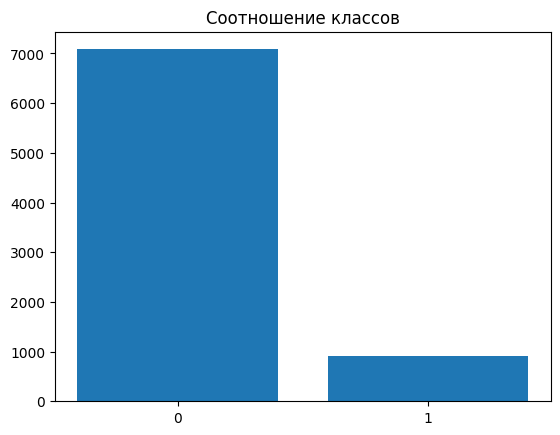

In [9]:
plt.close()
indexes = [0, 1]
cnts = data['is_safe'].value_counts().values

plt.title("Соотношение классов")
plt.xticks(indexes)
plt.bar(indexes, cnts)
plt.show()

### Как мы видим, наблюдается дизбаланс классов, проведём oversampling при помощи библиотеки imbalanced learn

#### Изучив проблему в гугле я нашёл [документацию](https://imbalanced-learn.org/stable/references/generated/imblearn.over_sampling.RandomOverSampler.html) к этой библиотеке и, посмотрев на примеры её работы, решил, что лучшим решением для oversampling будет RandomOversampling, т.к. синтетически сгенерированные данные могут быть неправильными.

In [10]:
feature_cols = data.columns[:-2]
len(feature_cols)

19

In [11]:
from imblearn.over_sampling import RandomOverSampler
X = data[feature_cols]
y = data['is_safe']
X_resampled, y_resampled = RandomOverSampler().fit_resample(X, y)
data = pd.concat([X_resampled, y_resampled], axis=1)

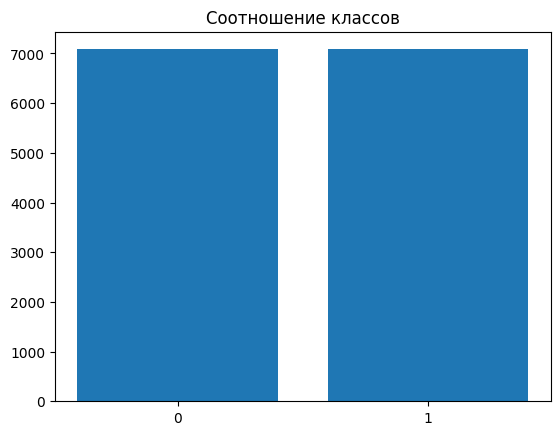

In [12]:
plt.close()
indexes = [0, 1]
cnts = data['is_safe'].value_counts().values

plt.title("Соотношение классов")
plt.xticks(indexes)
plt.bar(indexes, cnts)
plt.show()

#### Рассмотрим гистограммы для числовых признаков

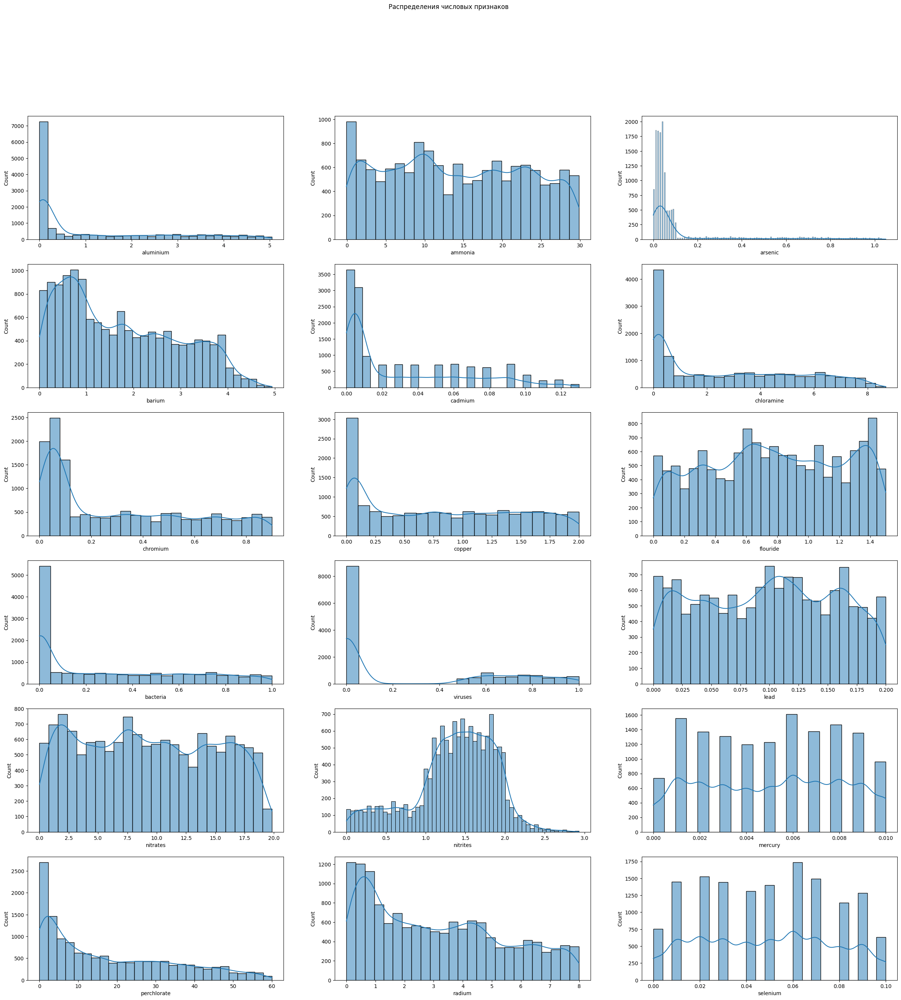

In [13]:
import seaborn as sns

fig, ax = plt.subplots(6, 3, figsize = (30, 30))
fig.suptitle('Распределения числовых признаков')
for i in range(18):
    sns.histplot(data[feature_cols[i]], ax = ax[i//3][i%3], kde=True)
plt.show()

#### Можно заметить, что у числового признака с названием arsenic имеются выбросы выше значения 0.1, удалим их

In [14]:
data = data.loc[data['arsenic'] < 0.1]

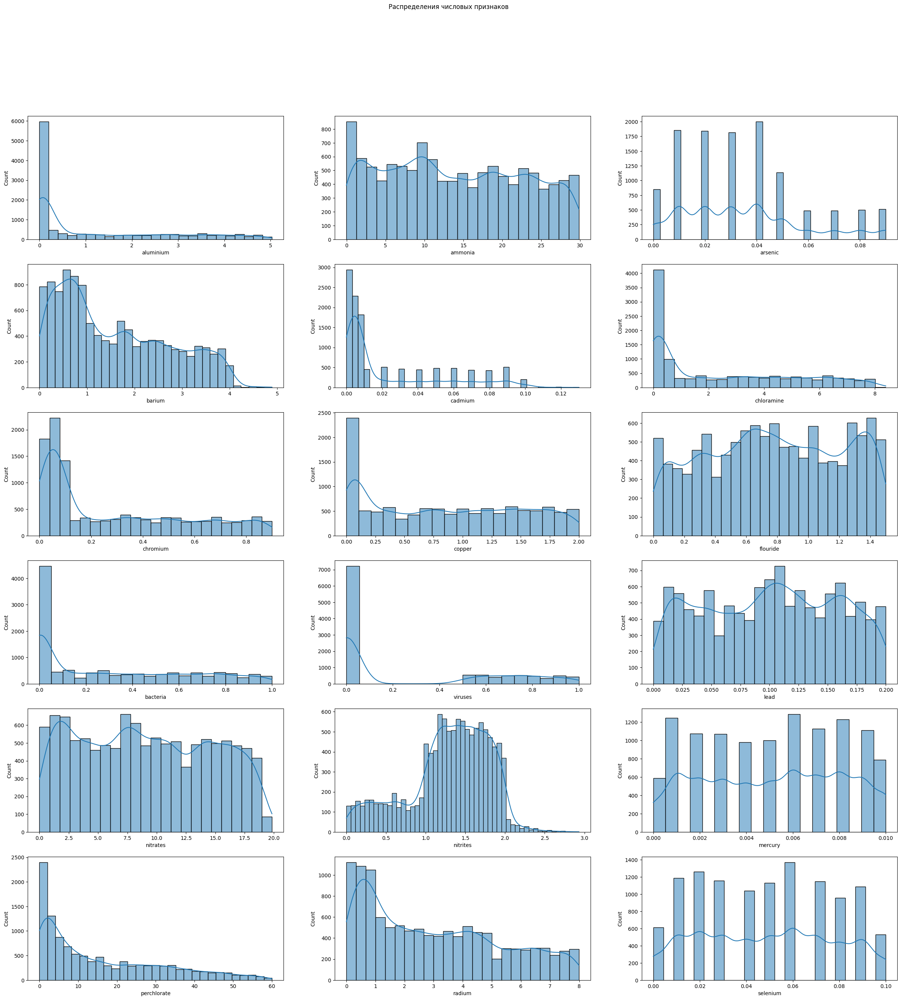

In [15]:
import seaborn as sns

fig, ax = plt.subplots(6, 3, figsize = (30, 30))
fig.suptitle('Распределения числовых признаков')
for i in range(18):
    sns.histplot(data[feature_cols[i]], ax = ax[i//3][i%3], kde=True)
plt.show()

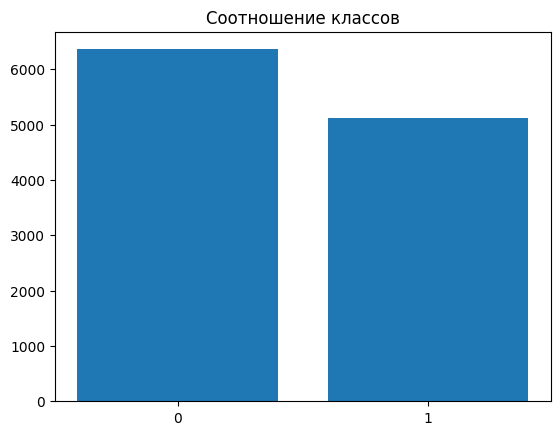

In [16]:
plt.close()
indexes = [0, 1]
cnts = data['is_safe'].value_counts().values

plt.title("Соотношение классов")
plt.xticks(indexes)
plt.bar(indexes, cnts)
plt.show()

Посмотрим на общую характеристику наших данных

In [17]:
data.describe()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,is_safe
count,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000,11485.000000
mean,1.191986,13.806465,0.034577,1.562205,0.023094,2.499047,0.288195,0.860177,0.777737,0.307817,0.276929,0.100606,9.139707,1.290374,0.005117,15.911545,3.017550,0.048756,0.162444,0.553766
std,1.537037,8.776251,0.023592,1.156792,0.029348,2.557118,0.280149,0.640253,0.430069,0.325900,0.366652,0.056488,5.547407,0.512896,0.003004,15.589965,2.316676,0.028984,0.148900,0.497122
min,0.000000,-0.030000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.050000,6.310000,0.020000,0.580000,0.003000,0.160000,0.050000,0.200000,0.430000,0.000000,0.001000,0.050000,4.210000,1.030000,0.002000,2.720000,0.880000,0.020000,0.040000,0.000000
50%,0.140000,13.290000,0.030000,1.260000,0.007000,1.530000,0.150000,0.820000,0.780000,0.200000,0.006000,0.103000,8.900000,1.370000,0.005000,10.090000,2.600000,0.050000,0.090000,1.000000
75%,2.320000,21.540000,0.050000,2.460000,0.040000,4.600000,0.510000,1.430000,1.150000,0.590000,0.650000,0.150000,14.010000,1.680000,0.008000,26.800000,4.770000,0.070000,0.270000,1.000000
max,5.030000,29.840000,0.090000,4.890000,0.130000,8.390000,0.900000,2.000000,1.500000,1.000000,1.000000,0.200000,19.830000,2.930000,0.010000,60.010000,7.990000,0.100000,0.500000,1.000000


In [18]:
data.corr()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,is_safe
aluminium,1.000000,0.025255,-0.274498,0.312286,-0.449475,0.406325,0.406476,0.194107,-0.013156,0.055431,-0.068880,0.030386,-0.031321,0.294836,0.004542,0.318443,0.300986,-0.001383,0.419671,0.542092
ammonia,0.025255,1.000000,-0.057595,0.008325,-0.034397,0.041545,0.088562,0.041526,-0.015291,0.059998,0.085373,-0.037990,-0.004730,-0.046583,0.015059,-0.082231,-0.008663,0.046740,0.013906,-0.020736
arsenic,-0.274498,-0.057595,1.000000,-0.211377,0.356836,-0.304254,-0.283542,-0.136527,-0.005152,-0.098878,-0.004950,-0.032081,-0.022714,-0.215287,-0.009789,-0.292380,-0.169443,-0.025726,-0.275596,-0.296207
barium,0.312286,0.008325,-0.211377,1.000000,-0.356012,0.353280,0.318168,0.140279,-0.001625,0.109985,0.006218,0.027358,-0.005458,0.283780,0.013984,0.385222,0.229521,0.053663,0.340319,0.272021
cadmium,-0.449475,-0.034397,0.356836,-0.356012,1.000000,-0.521995,-0.492075,-0.212708,-0.006140,-0.158287,0.022751,-0.018565,0.007078,-0.335985,0.009345,-0.452741,-0.316195,0.017235,-0.442997,-0.489383
chloramine,0.406325,0.041545,-0.304254,0.353280,-0.521995,1.000000,0.485050,0.220363,0.022697,0.183207,0.019322,0.037792,-0.001885,0.362435,-0.032332,0.457280,0.323622,0.006393,0.415777,0.423933
chromium,0.406476,0.088562,-0.283542,0.318168,-0.492075,0.485050,1.000000,0.209909,0.005711,0.151311,-0.008843,0.034057,-0.022758,0.334777,-0.017636,0.436213,0.263859,0.032692,0.434658,0.400461
copper,0.194107,0.041526,-0.136527,0.140279,-0.212708,0.220363,0.209909,1.000000,0.012362,0.193997,0.046143,0.077067,0.006239,0.255909,0.022105,0.188127,0.107826,-0.004481,0.157577,0.070023
flouride,-0.013156,-0.015291,-0.005152,-0.001625,-0.006140,0.022697,0.005711,0.012362,1.000000,0.022649,0.019873,0.002845,-0.032646,-0.012073,0.001771,-0.018194,0.017694,0.032510,0.015829,0.011246
bacteria,0.055431,0.059998,-0.098878,0.109985,-0.158287,0.183207,0.151311,0.193997,0.022649,1.000000,0.740185,0.054704,0.009669,0.272512,0.002169,0.172156,0.086740,0.000307,0.153221,-0.021691


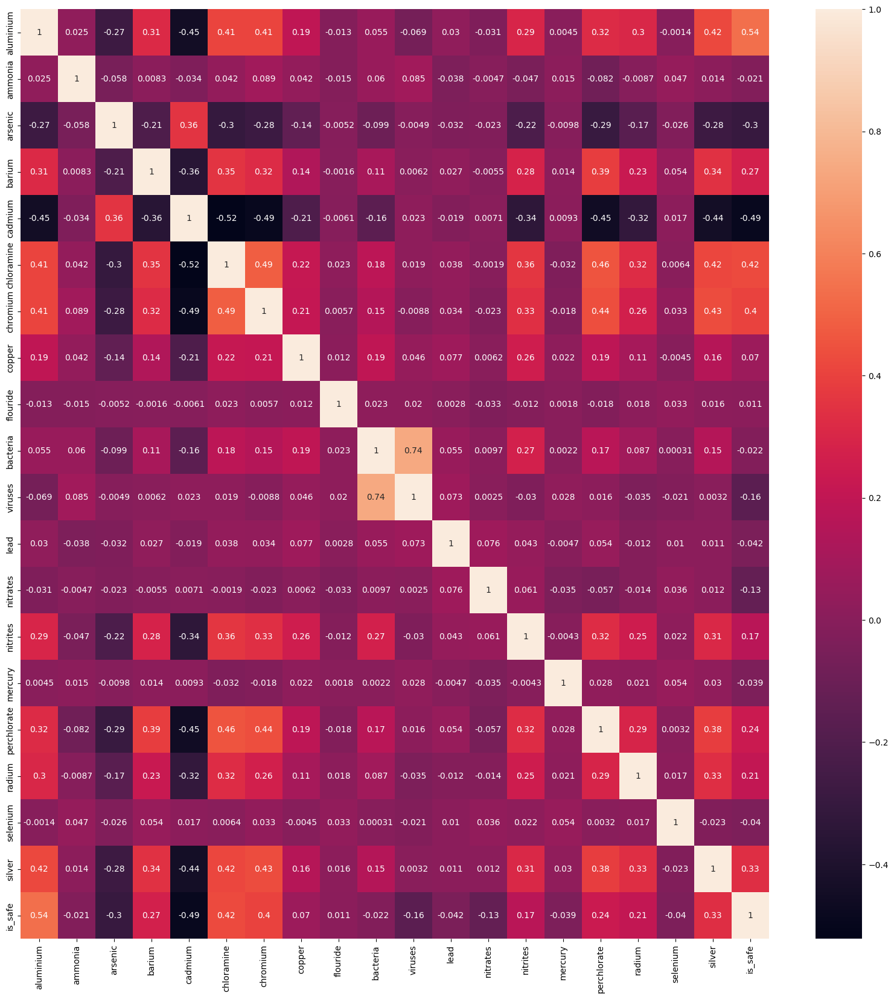

In [19]:
fig, ax = plt.subplots(figsize = (20, 20))
sns.heatmap(data.corr(), annot=True, ax=ax)
pass

Посмотрим на корреляцию данных с целевой переменной

In [20]:
data.corrwith(data['is_safe']).sort_values()

cadmium       -0.489383
arsenic       -0.296207
viruses       -0.162955
nitrates      -0.126169
lead          -0.042368
selenium      -0.039686
mercury       -0.039248
bacteria      -0.021691
ammonia       -0.020736
flouride       0.011246
copper         0.070023
nitrites       0.167668
radium         0.208141
perchlorate    0.237122
barium         0.272021
silver         0.332370
chromium       0.400461
chloramine     0.423933
aluminium      0.542092
is_safe        1.000000
dtype: float64

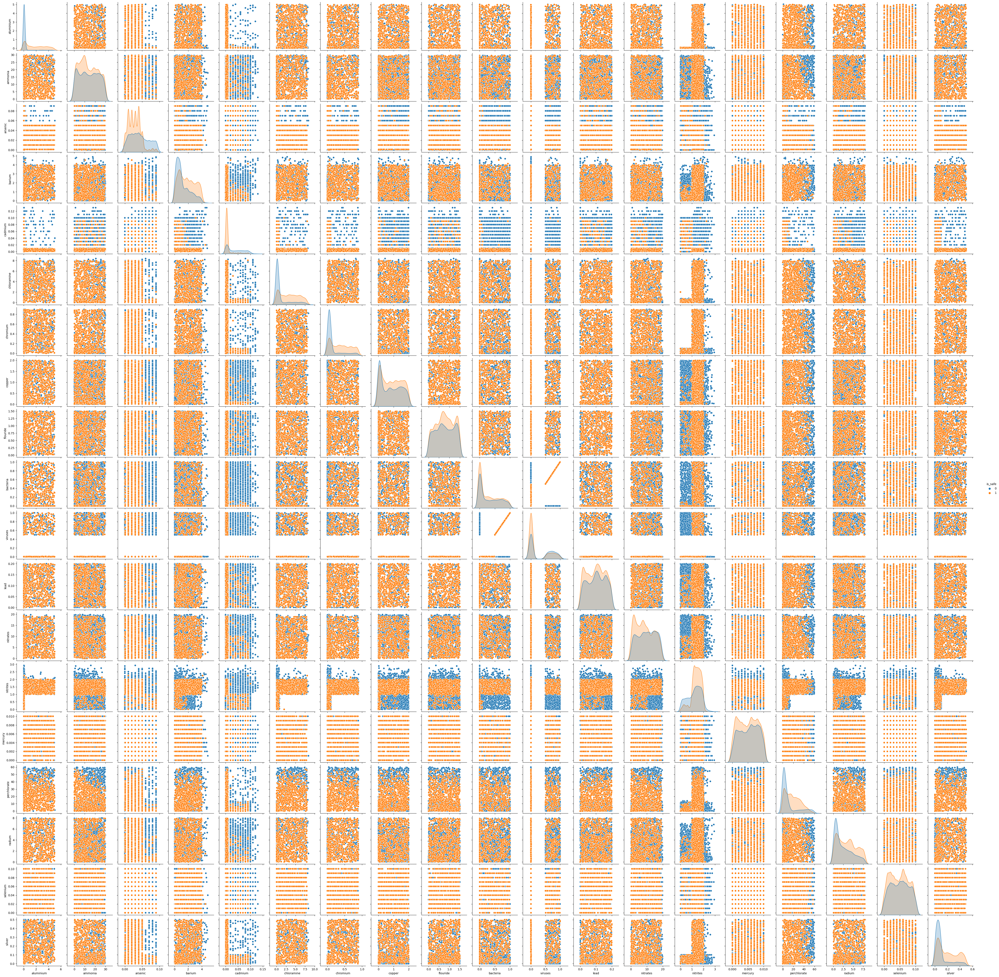

In [21]:
sns.pairplot(data=data, hue='is_safe')
pass

Попарная визуализация признаков

## Обучение модели

In [26]:
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import max_error, mean_squared_error, mean_absolute_error, r2_score
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, RocCurveDisplay, ConfusionMatrixDisplay
from sklearn.preprocessing import normalize

In [27]:
def scores(model, X, y_true):
    y_pred = model.predict(X)

    print("Accuracy:", accuracy_score(y_true, y_pred))
    print("Recall:", recall_score(y_true, y_pred))
    print("Precision:", precision_score(y_true, y_pred))
    figure = plt.figure(figsize = (20, 5))
    matr = confusion_matrix(y_true, y_pred)
    ax = plt.subplot(1, 2, 1)
    ConfusionMatrixDisplay(matr).plot(ax = ax)
    ax = plt.subplot(1, 2, 2)

    RocCurveDisplay.from_estimator(estimator=model, X=X, y=y_true, name="ROC-кривая", ax=ax)

In [28]:
x = data.drop(columns = 'is_safe').to_numpy()
y = data['is_safe'].to_numpy()
train_data, test_data, train_labels, test_labels = train_test_split(x, y, train_size=0.8, random_state=1)
train_data = normalize(train_data, norm="max", axis=0)
test_data = normalize(test_data, norm="max", axis=0)

### Логистическая регрессия

Сделаем GridSearch параметров для создания модели логистической регресии

Accuracy: 0.8119286025250326
Recall: 0.8284118116520351
Precision: 0.8270916334661355


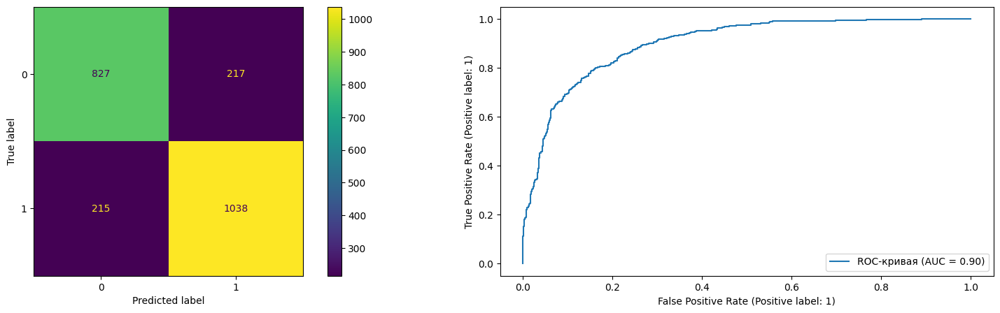

In [29]:
gscv = GridSearchCV(Pipeline([("logreg", LogisticRegression())]),
                    {"logreg__penalty" : ["l2", "none"],
                     "logreg__solver" : ["newton-cg", "lbfgs"],
                     "logreg__max_iter" : [1000, 10000]})

gscv.fit(train_data, train_labels)
logreg_best = gscv.best_estimator_
scores(logreg_best, test_data, test_labels)